## Import Utils and MatPlotLib Params

In [1]:
import numpy as np
import rasterio
import matplotlib.pyplot as plt
import matplotlib.colors as clrs
import pandas as pd
import shutil
from astropy.visualization import ZScaleInterval
from sklearn.mixture import GaussianMixture
from astropy.stats import sigma_clip
import warnings

warnings.filterwarnings("ignore")

mlp_params = {
    "figure.figsize": [9, 6],
    "axes.labelsize": 22,
    "axes.titlesize": 24,
    "axes.titlepad": 15,
    "figure.titlesize": 24,
    "axes.labelpad": 10,
    "font.size": 16,
    "legend.fontsize": 18,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "text.usetex": True if shutil.which("latex") else False,
    "font.family": "serif",
    "xtick.minor.visible": True,
    "ytick.minor.visible": True,
    "xtick.top": True,
    "ytick.left": True,
    "ytick.right": True,
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.minor.size": 2.5,
    "xtick.major.size": 5,
    "ytick.minor.size": 2.5,
    "ytick.major.size": 5,
    "axes.axisbelow": True,
    "figure.dpi": 200,
}
plt.rcParams.update(mlp_params)

## Set the Al/Si and Mg/Si TIFF file paths

Set the Al/Si and Mg/Si TIFF file paths. `base_image` is the base lunar map. `file_path_al` and `file_path_mg` are the TIFF filepahs generated in the appropriate `resultsdir` by the mapping code

In [2]:
file_path_al = (
    "Al_Si_combined.tiff"
)
file_path_mg = (
    "Mg_Si_combined.tiff"
)
base_image = "lroc_color_poles_4k.tif"

with rasterio.open(base_image) as src:
    base_data = np.stack([src.read(i + 1) for i in range(3)], axis=-1)

with rasterio.open(file_path_al) as src:
    data_al = src.read(1)  # Read the first band
    err_al = src.read(2)
    transform = src.transform
    nodata_val = 9999  # Use file's nodata value or default to 9999
data_al = np.copy(data_al)
err_al = np.copy(err_al)
data_al = np.ma.masked_greater_equal(data_al, nodata_val)
err_al = np.ma.masked_greater_equal(err_al, nodata_val)
data_values_al = data_al.filled(9999.0)
data_err_al = err_al.filled(9999.0)
data_flat_al = data_al.flatten()

with rasterio.open(file_path_mg) as src:
    data_mg = src.read(1)  # Read the first band
    err_mg = src.read(2)
    transform = src.transform
    nodata_val = 9999  # Use file's nodata value or default to 9999
data_mg = np.copy(data_mg)
err_mg = np.copy(err_mg)
data_mg = np.ma.masked_greater_equal(data_mg, nodata_val)
err_mg = np.ma.masked_greater_equal(err_mg, nodata_val)
data_values_mg = data_mg.filled(9999.0)
data_err_mg = err_mg.filled(9999.0)
data_flat_mg = data_mg.flatten()

# set lat-lon grid
n_lat, n_lon = data_al.shape
lons = np.linspace(-180, 180, n_lon)  # Longitude from -180 to 180
lats = np.linspace(90, -90, n_lat)  # Latitude from 90 to -90 (inverted)
lons_grid, lats_grid = np.meshgrid(lons, lats)
lat_flat = lats_grid.flatten()
lon_flat = lons_grid.flatten()

df = pd.DataFrame(
    {
        "latitude": lat_flat,
        "longitude": lon_flat,
        "Al_ratio": data_flat_al,
        "Mg_ratio": data_flat_mg,
    }
)

df_filtered = df[df["Mg_ratio"] != 9999.0]
df_filtered = df_filtered[abs(df_filtered["latitude"]) < 60]
df_filtered = df_filtered[df_filtered["Al_ratio"] != 9999.0]
df_filtered.dropna(inplace=True)

## Histogram for Al/Si ratio

Run the block below to get a histogram of Al/Si flux ratio $\displaystyle\mathcal{R}^{Al}_{Si}$ across the lunar surface. We observe a bimodal distribution, where the two modes correspond to values observed in the lunar maria VS the lunar highlands. This will allow us to classify clusters of element ratio groups based on Al ratio, which will also be validated through terrain differences. The clustering methods are presented in the blocks following preliminary analysis.


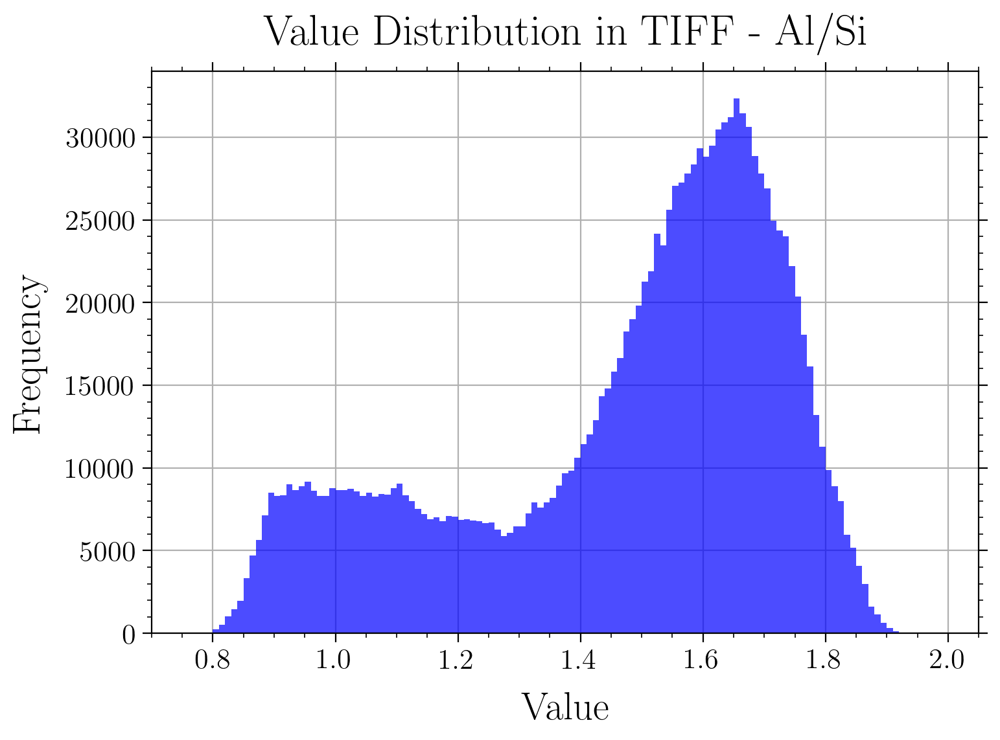

In [3]:
plt.figure(figsize=(8, 6))
plt.hist(df_filtered["Al_ratio"], bins=200, color="blue", alpha=0.7, range=(0, 2))
plt.title("Value Distribution in TIFF - Al/Si")
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.xlim(0.7, 2.05)
plt.grid()
plt.tight_layout()
plt.show()

## Al/Si Ratio Heatmap

The block below plots the TIFF file onto the lunar surface as a heatmap. We observe and visually extract marial VS highland terrain separation based on the Al/Si ratio. In subsequent sections, we will do further clustering using other elemental ratios in order to sharply extract geographical features and possibly obtain further classification within the maria and the highlands.

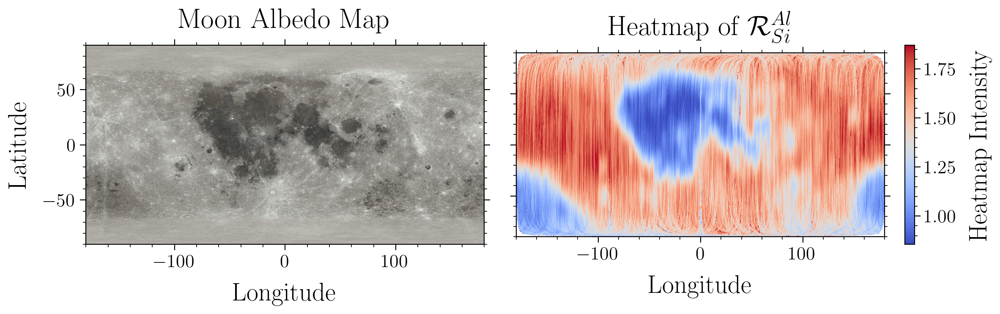

In [4]:
zmin, zmax = ZScaleInterval().get_limits(data_al[~data_al.mask])
fig, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=True)
plt.subplot(1, 2, 1)
plt.imshow(
    base_data,
    extent=(-180, 180, -90, 90),
    interpolation="nearest",
    alpha=1,  # Full opacity for the base layer
)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Moon Albedo Map")
plt.subplot(1, 2, 2)
plt.imshow(
    data_al,
    extent=(-180, 180, -90, 90),
    cmap="coolwarm",  # Ensure the same extent as the base layer
    interpolation="nearest",
    alpha=1,  # Adjust opacity for overlay
    vmin=zmin,
    vmax=zmax,
)
plt.colorbar(label="Heatmap Intensity", fraction=0.025, pad=0.05)
plt.title(r"Heatmap of $\mathcal{R}^{Al}_{Si}$")
plt.xlabel("Longitude")
plt.tight_layout()
plt.show()

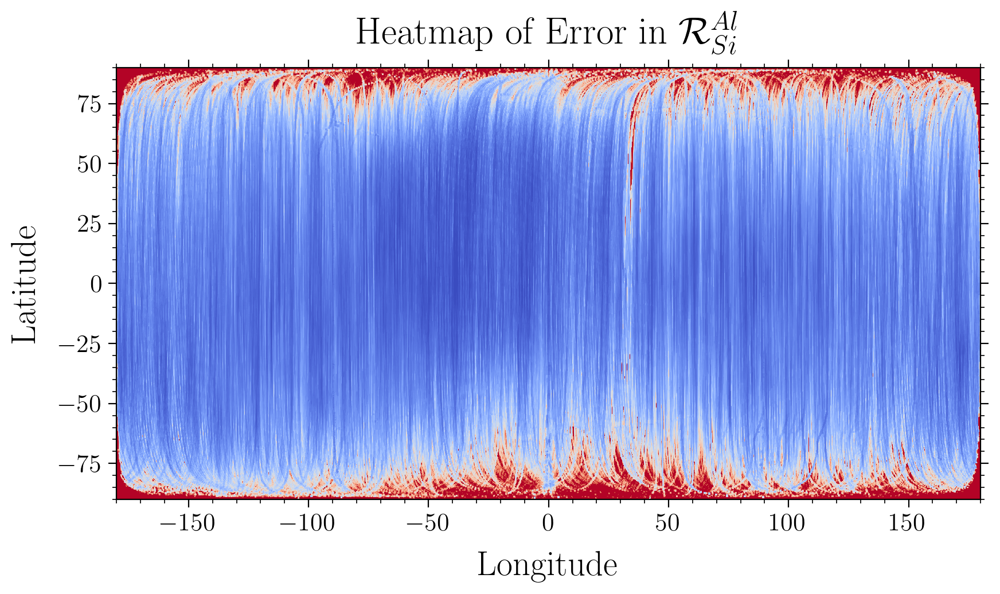

In [5]:
zmin, zmax = ZScaleInterval().get_limits(data_err_al)
plt.imshow(
    data_err_al,
    extent=(-180, 180, -90, 90),
    interpolation="nearest",
    alpha=1,  # Full opacity for the base layer
    cmap="coolwarm",
    vmin=zmin,
    vmax=zmax,
)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title(r"Heatmap of Error in $\mathcal{R}^{Al}_{Si}$")
plt.tight_layout()
plt.show()

## Histogram for Mg/Si ratio

Run the block below to get histogram for Mg/Si values across the lunar surface. It is unimodal and hence does not demonstrate a clear separation between maria and highland values.

As suggested by [Gloudemans et al.](https://www.aanda.org/articles/aa/pdf/2021/05/aa40321-21.pdf), the Mg/Si ratio is ill-suited for inference by itself. We will observe that combining it with the above Al/Si classification is well-suited for compositional classification that matches geographical classification from previous literature.

As seen in the above uncertainty plot of the ratio data, we note that tracks in the $35^\circ - 40^\circ$ longitude have high uncertainty for all elemental ratios. In particular, this leads to an unusually high Mg/Si ratio observed in those longitudes. The _Mare Tranquilatis_ which has a low Mg island [Yang et al.](https://www.nature.com/articles/s41467-023-43358-0) is not correctly detected even with clustering.

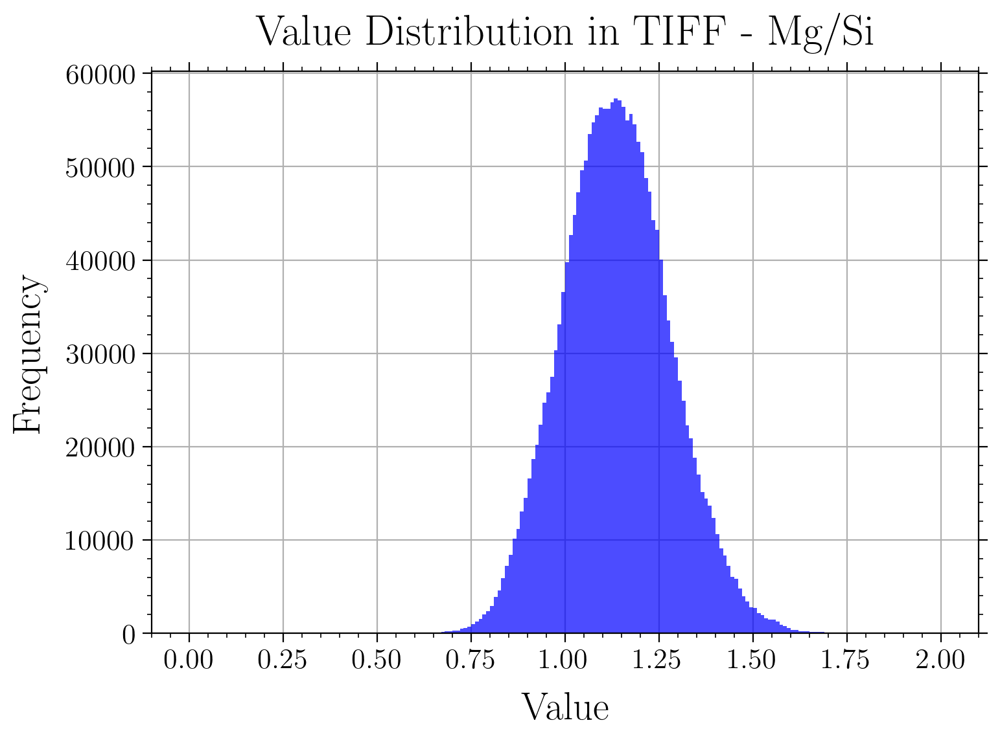

In [6]:
plt.figure(figsize=(8, 6))
plt.hist(data_mg.flatten(), bins=200, color="blue", alpha=0.7, range=(0, 2))
plt.title("Value Distribution in TIFF - Mg/Si")
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.grid()
plt.tight_layout()
plt.show()

## Mg/Si Ratio Heatmap

The block below plots the Mg/Si TIFF file onto the lunar surface as a heatmap. In subsequent sections, we will do further clustering using other elemental ratios in order to sharply extract geographical features and possibly obtain further classification within the maria and the highlands.

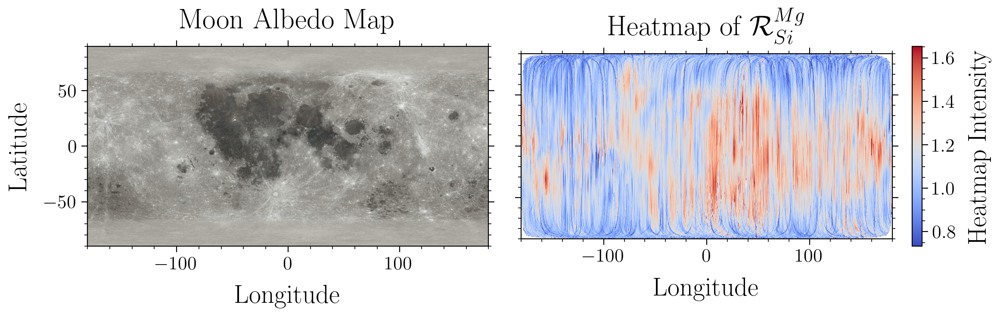

In [7]:
zmin, zmax = ZScaleInterval().get_limits(data_mg[~data_mg.mask])
fig, axs = plt.subplots(1, 2, figsize=(12, 6), sharey=True)
plt.subplot(1, 2, 1)
plt.imshow(
    base_data,
    extent=(-180, 180, -90, 90),
    interpolation="nearest",
    alpha=1,  # Full opacity for the base layer
)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Moon Albedo Map")
plt.subplot(1, 2, 2)
plt.imshow(
    data_mg,
    extent=(-180, 180, -90, 90),
    cmap="coolwarm",  # Ensure the same extent as the base layer
    interpolation="nearest",
    alpha=1,  # Adjust opacity for overlay
    vmin=zmin,
    vmax=zmax,
)
plt.colorbar(label="Heatmap Intensity", fraction=0.025, pad=0.05)
plt.title(r"Heatmap of $\mathcal{R}^{Mg}_{Si}$")
plt.xlabel("Longitude")
plt.tight_layout()
plt.show()

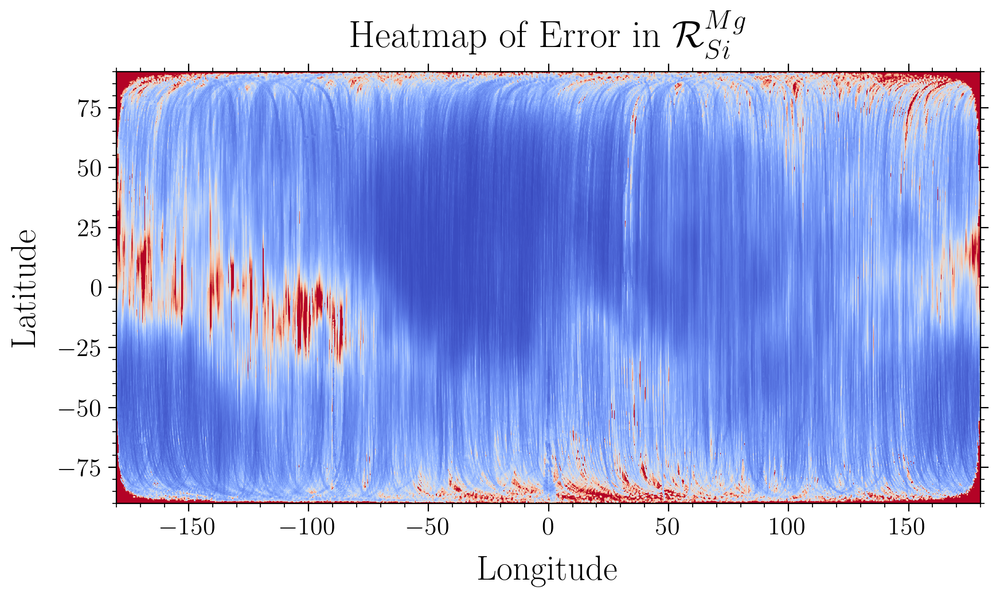

In [8]:
zmin, zmax = ZScaleInterval().get_limits(data_err_mg)
plt.imshow(
    data_err_mg,
    extent=(-180, 180, -90, 90),
    interpolation="nearest",
    alpha=1,  # Full opacity for the base layer
    cmap="coolwarm",
    vmin=zmin,
    vmax=zmax,
)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title(r"Heatmap of Error in $\mathcal{R}^{Mg}_{Si}$")
plt.tight_layout()
plt.show()

# Al/Si Ratio Classification

We fit a double Gaussian to the Al histogram. The intersection point of the two Gaussians (close to the histogram's minimum) is used as a threshold value for Al ratio in subsequent analysis. Run the block below to fit the double Gaussian and obtain the intersection point and fit parameters.

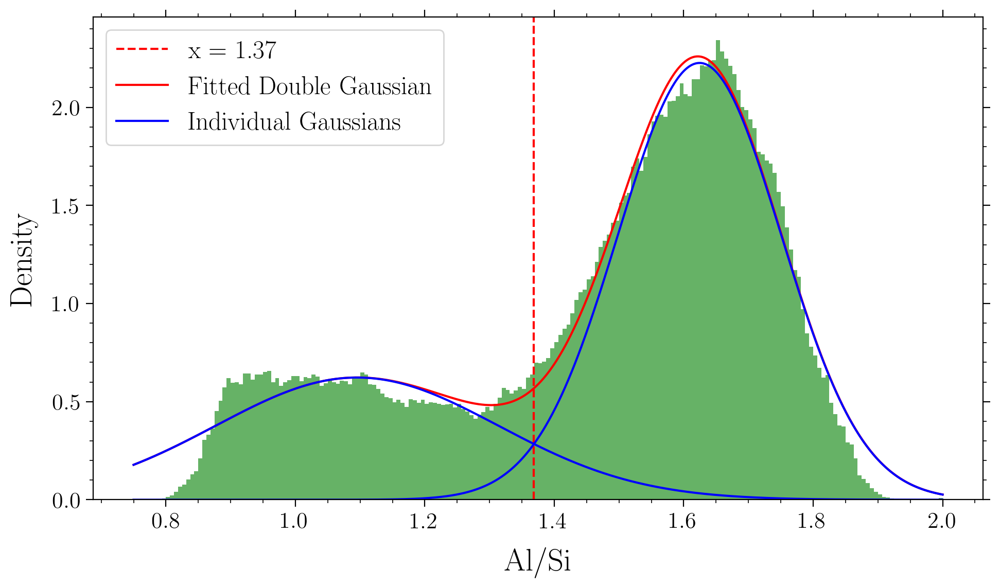

Fitted Parameters:
    Amplitude 1: 0.62
    Mean 1: 1.10
    Std Dev 1: 0.22
    Amplitude 2: 2.23
    Mean 2: 1.62
    Std Dev 2: 0.13
    X-Intersection: 1.37


In [9]:
from scipy.optimize import curve_fit


def fit_gaussians(df):
    al_ratio = df["Al_ratio"].values
    al_ratio = np.clip(al_ratio, 0.75, 2)
    # Fit a Gaussian curve to the data
    hist, bin_edges = np.histogram(al_ratio, bins=200, density=True)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    def double_gaussian(x, amp1, mean1, stddev1, amp2, mean2, stddev2):
        return amp1 * np.exp(-((x - mean1) ** 2) / (2 * stddev1**2)) + amp2 * np.exp(
            -((x - mean2) ** 2) / (2 * stddev2**2)
        )

    def gaussian(x, amp, mean, stddev):
        return amp * np.exp(-((x - mean) ** 2) / (2 * stddev**2))

    # Fit a double Gaussian curve to the data
    popt, _ = curve_fit(
        double_gaussian, bin_centers, hist, p0=[0.5, 1, 0.15, 2, 1.6, 0.15]
    )

    # Calculate the fitted double Gaussian curve
    x = np.linspace(0.75, 2, 1000)
    fitted_double_curve = double_gaussian(x, *popt)
    fitted_curve1 = gaussian(x, *popt[:3])
    fitted_curve2 = gaussian(x, *popt[3:])

    # Find the intersection of the two Gaussians
    def find_intersection(x, y1, y2):
        idx = np.argwhere(np.diff(np.sign(y1 - y2)) != 0).reshape(-1) + 0
        return x[idx], y1[idx]

    x_intersect, y_intersect = find_intersection(x, fitted_curve1, fitted_curve2)
    x_intersect = x_intersect[0]

    # Plot the intersection point
    # Plot the histogram of al_ratio with the fitted double Gaussian curve
    plt.figure(figsize=(10, 6))
    plt.hist(al_ratio, bins=200, density=True, alpha=0.6, color="g", range=(0.75, 2))
    plt.axvline(x_intersect, linestyle="--", color="r", label=f"x = {x_intersect:.2f}")
    plt.plot(x, fitted_double_curve, "-r", label="Fitted Double Gaussian")
    plt.plot(x, fitted_curve1, "-b", label="Individual Gaussians")
    plt.plot(x, fitted_curve2, "-b")

    plt.xlabel("Al/Si")
    plt.ylabel("Density")
    plt.legend()
    plt.tight_layout()
    plt.show()

    print(
        "Fitted Parameters:\n\
    Amplitude 1: {:.2f}\n\
    Mean 1: {:.2f}\n\
    Std Dev 1: {:.2f}\n\
    Amplitude 2: {:.2f}\n\
    Mean 2: {:.2f}\n\
    Std Dev 2: {:.2f}\n\
    X-Intersection: {:.2f}".format(
            *popt, x_intersect
        )
    )
    return x_intersect, popt


al_intersect, popt = fit_gaussians(df_filtered)

al_peak_1_sigma = popt[2]
al_peak_1 = popt[1]

# Al/Si and Mg/Si Compositional Clusters

In this section, we make a scatter plot of Mg/Si vs Al/Si ratio for various points of the lunar surface. Since the maps contain $\approx 8,000,000$ points, we sample some $50,000-100,000$ points uniformly at random. The plot is made with density, red respresenting high density of points. Set the `sample_size` parameter to change the number of sampled points.

It is clearly observed that the Al threshold separates two clusters, with the high Al cluster having a much larger density. Further, among the high Al points, two distinct lobes are observed visually. We attempt to classify these three observed clusters through 2D Gaussian Mixture Models.

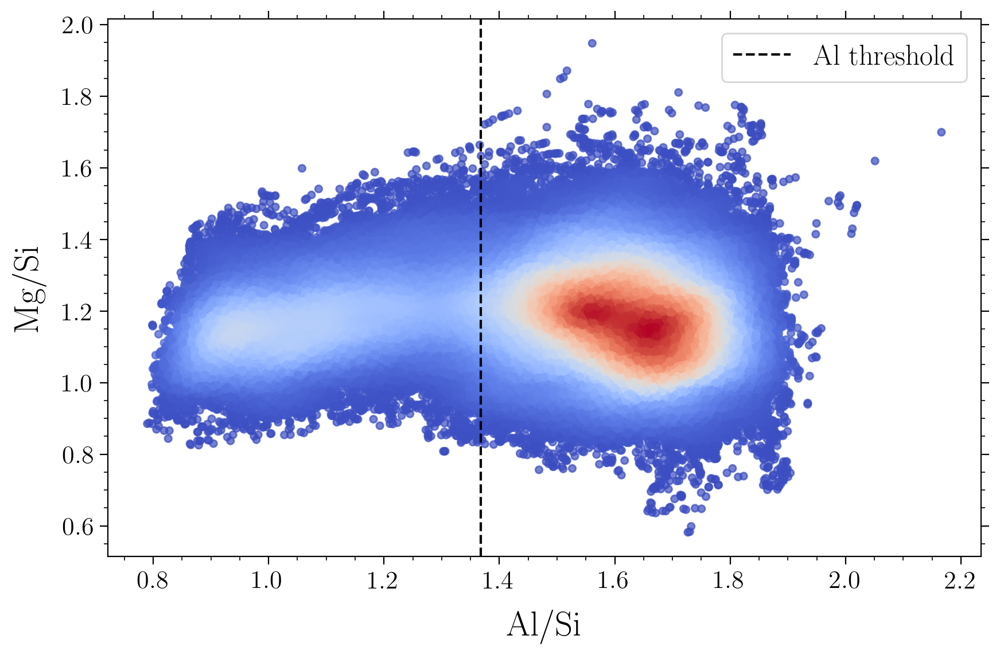

In [10]:
from scipy.stats import gaussian_kde

sample_size = 200000


def density_scatter_ratios(df):

    mg_ratio = df["Mg_ratio"].values
    al_ratio = df["Al_ratio"].values

    kde = gaussian_kde([al_ratio, mg_ratio])([al_ratio, mg_ratio])
    plt.xlabel("Al/Si")
    plt.ylabel("Mg/Si")
    plt.scatter(al_ratio, mg_ratio, c=kde, s=20, alpha=0.7, cmap="coolwarm")
    plt.axvline(x=al_intersect, color="black", linestyle="--", label="Al threshold")
    plt.legend()
    plt.tight_layout()
    plt.show()


sampled_df = df_filtered.sample(n=sample_size)
density_scatter_ratios(sampled_df)

## Gaussian Mixture Model

In this block, we separate the high Al/Si points, and apply a 2D-Gaussian mixture with 2 peaks to fit the density plot. A plot of the gaussian density contours is made by running the block. Further, the GMM classification boundary is used to separate the two clusters, plotted based on probability values. 

Set the `cluster_colors` array with 2 colors for the 2 clusters.

We can see that the ratios Mg/Si and Al/Si are negatively correlated in the high Al cluster.

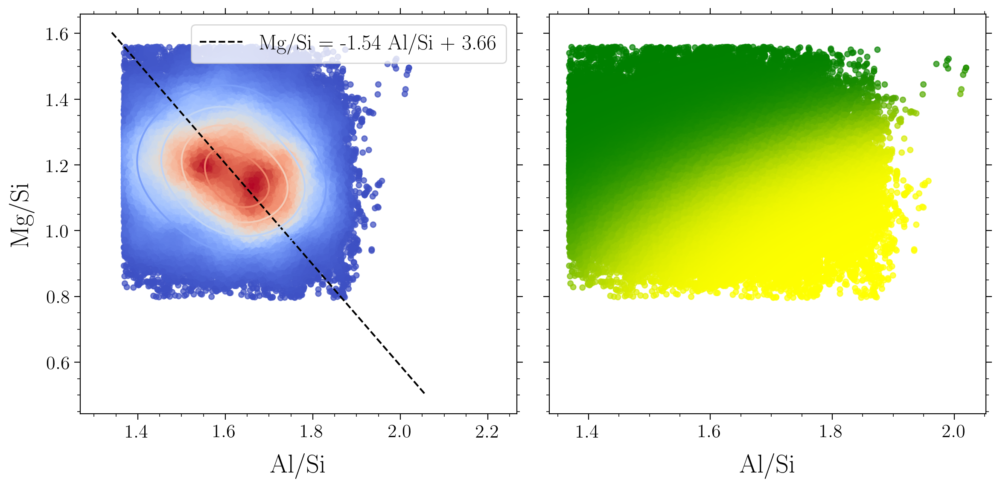

In [11]:
cluster_colors = ["yellow", "green"]
cluster_colors_rgb = [clrs.to_rgb(clr) for clr in cluster_colors]


def high_al_region_cluster(df):
    # Extract relevant columns
    al_ratio = df["Al_ratio"]
    lon = df["longitude"]
    mg_ratio = sigma_clip(df["Mg_ratio"])  # Apply sigma clipping to Mg_ratio

    colors = np.where(al_ratio > al_intersect, "red", "yellow")

    # Filter out only the "red" points for GMM fitting
    red_al_ratio = al_ratio[colors == "red"]
    red_mg_ratio = mg_ratio[colors == "red"]
    colors = colors[colors == "red"]

    # Stack the data for GMM fitting
    stack = np.vstack([red_al_ratio, red_mg_ratio]).T
    kde = gaussian_kde(stack.T)(stack.T)

    # Fit a Gaussian Mixture Model (GMM)
    gmm = GaussianMixture(n_components=2).fit(
        stack
    )  # You can adjust n_components as needed
    means = gmm.means_
    if means[0][0] > 1.6:
        cluster_colors = ["yellow", "green"]
    else:
        cluster_colors = ["green", "yellow"]
    cluster_colors_rgb = [clrs.to_rgb(clr) for clr in cluster_colors]
    x = np.linspace(0.5 * min(red_al_ratio), 1.5 * max(red_al_ratio), 100)

    # Create a grid for visualization
    x_grid = np.linspace(min(red_al_ratio) - 0.1, max(red_al_ratio) + 0.1, 100)
    y_grid = np.linspace(min(red_mg_ratio) - 0.1, max(red_mg_ratio) + 0.1, 100)
    X, Y = np.meshgrid(x_grid, y_grid)
    grid_points = np.vstack([X.ravel(), Y.ravel()]).T

    # Calculate the density (probabilities) for each point in the grid
    log_density = gmm.score_samples(grid_points)
    density = np.exp(log_density).reshape(X.shape)
    fig, ax = plt.subplots(1, 2, sharey=True, figsize=(12, 6))
    ax[0].set_xlabel("Al/Si")
    ax[0].set_ylabel("Mg/Si")
    ax[0].scatter(red_al_ratio, red_mg_ratio, c=kde, s=20, alpha=0.7, cmap="coolwarm")
    x = np.linspace(0.98 * min(red_al_ratio), 0.95 * max(red_al_ratio), 100)
    ax[0].plot(
        x,
        means[0][1]
        + (means[1][1] - means[0][1]) / (means[1][0] - means[0][0]) * (x - means[0][0]),
        "k--",
        label=f"Mg/Si = {(means[1][1] - means[0][1])/(means[1][0] - means[0][0]):.2f} Al/Si + {means[0][1] - (means[1][1] - means[0][1])/(means[1][0] - means[0][0])*means[0][0]:.2f}",
    )

    # Plot the GMM density as contours
    ax[0].contour(X, Y, density, levels=5, cmap="coolwarm")
    ax[0].legend(loc="upper right")

    # Plot the contour line which divides the plane into two based on the clusters
    # Predict the cluster for each point in the grid
    # Plot the scatter points for the "red" points with predicted cluster colors based on probability values
    cluster_labels = gmm.predict(stack)
    probabilities = np.sum(
        gmm.predict_proba(stack)[:, :, np.newaxis] * cluster_colors_rgb, axis=1
    )

    ax[1].set_xlabel("Al/Si")
    ax[1].scatter(
        red_al_ratio,
        red_mg_ratio,
        c=probabilities,
        s=20,
        alpha=0.7,
    )
    plt.tight_layout()
    plt.show()

    return gmm


gmm = high_al_region_cluster(sampled_df)

## Mg based classification

In this section, we classify the low Al datapoints based on the Mg ratio value. A preliminary bifurcation into 'high'(red) and 'low' (cyan) Mg is made using the median of Mg in the marial low-Al cluster. A $\sigma$-cut is also made on the low-Al peak, to mark the boundary region with color orange.

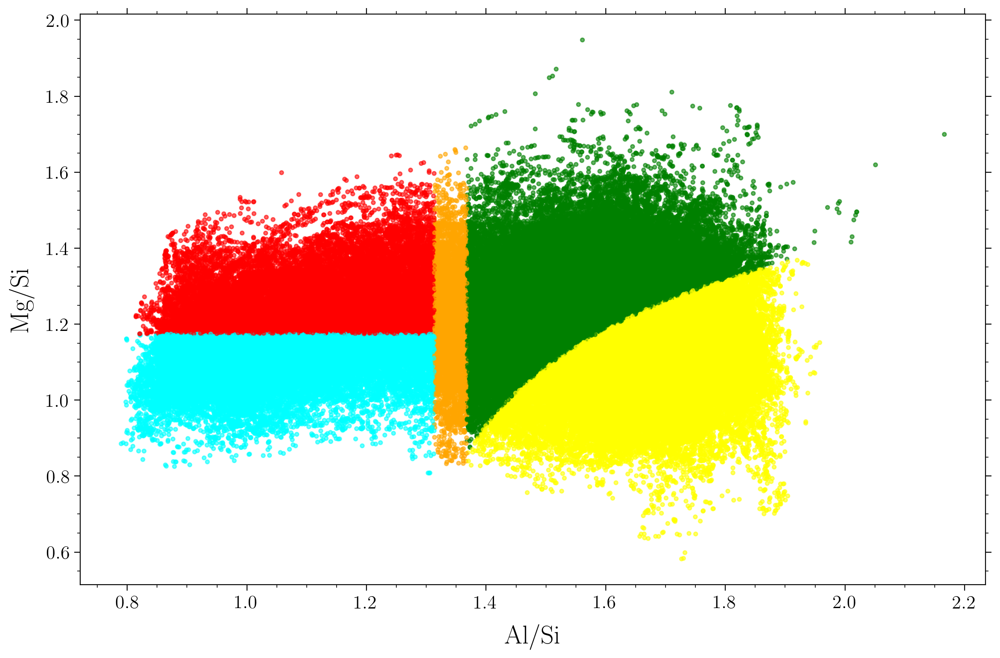

In [12]:
al_ratio = sampled_df["Al_ratio"]
mg_ratio = sampled_df["Mg_ratio"]
stack = np.vstack([al_ratio, mg_ratio]).T
colors = np.where(
    al_ratio < al_intersect,
    np.where(
        al_ratio < al_peak_1 + al_peak_1_sigma,
        np.where(
            mg_ratio < np.median(mg_ratio[al_ratio < al_intersect]), "cyan", "red"
        ),
        "orange",
    ),
    np.where(gmm.predict(stack), "green", "yellow"),
)
plt.figure(figsize=(12, 8))
plt.scatter(al_ratio, mg_ratio, c=colors, s=10, alpha=0.6)
plt.xlabel("Al/Si")
plt.ylabel("Mg/Si")
plt.tight_layout()
plt.show()

## Geographical Mapping of Compositional Clusters

This block plots all the above clusters onto the lunar map. We clearly observe among the marial points (cyan and red) classification based on Mg value matching the existing literature {TODO: cite Chang}. The orange region demarcates the boundary between marial and highland regions.

Further, among highland we observe a bifurcation which is roughly longitudinal into a high Mg and low Mg half, which also matches existing literature {TODO: cite}

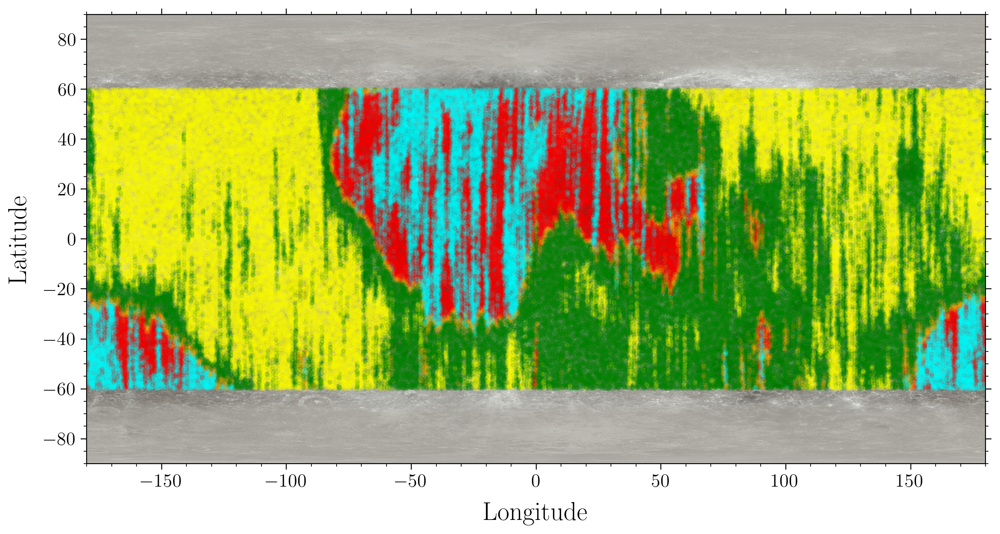

In [13]:
# Define the color condition (red if al_ratio > 1.3, blue otherwise)
def clusters(df_combined):
    al_ratio = df_combined["Al_ratio"]
    lon = df_combined["longitude"]
    lat = df_combined["latitude"]
    mg_ratio = df_combined["Mg_ratio"]

    # Create a scatter plot on top of
    # he base_data
    plt.figure(figsize=(12, 8))
    # plt.subplot(2, 1, 1)
    plt.imshow(base_data, extent=(-180, 180, -90, 90), interpolation="nearest", alpha=1)
    # plt.subplot(2, 1, 2)
    # Scatter plot of the points with colors based on al_ratio
    plt.scatter(lon, lat, c=colors, s=10, alpha=0.1)

    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.tight_layout()
    plt.show()
    plt.close()


clusters(sampled_df)

## Triple Gaussian Fit

Alternative to the above approach which is reliant on visual analysis, we can simply apply a 3 component gaussian mixture to separate the 3 components and recover major geographical features including the _Mare Moskoviense_ and the _Mare Chrisium_.

Set the `cluster_colors` parameter same as above.

[[1.5170568 1.2467481]
 [1.0626093 1.1786834]
 [1.6689545 1.1216573]]


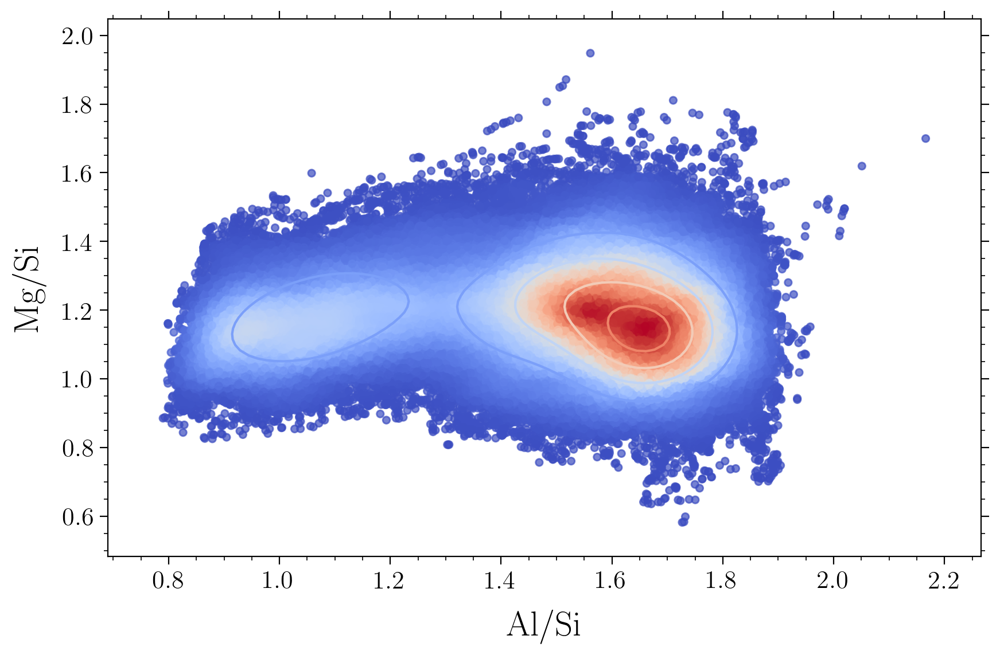

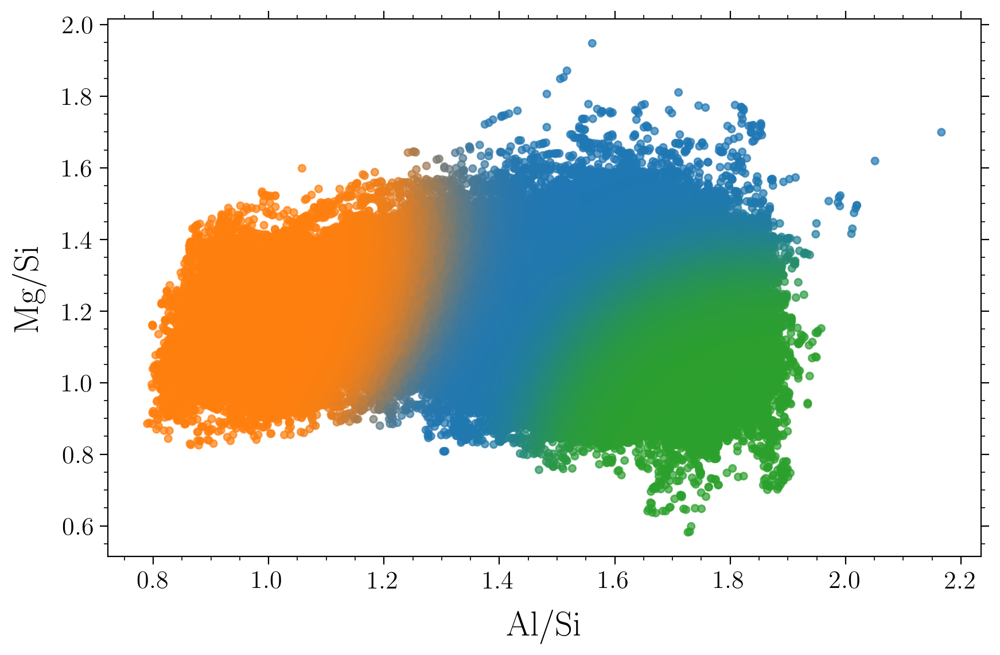

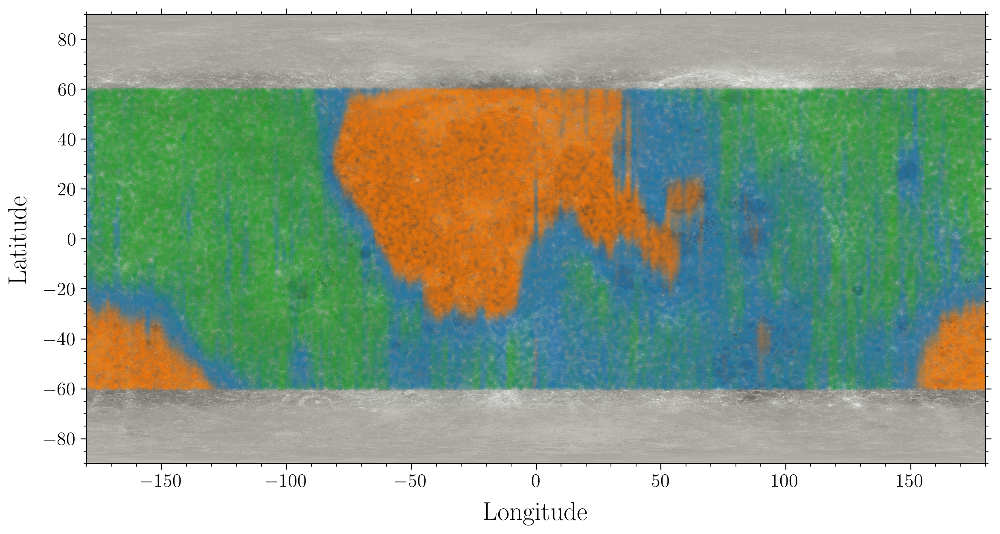

In [14]:
cluster_colors = [f"C{i}" for i in range(3)]
cluster_colors_rgb = np.array([clrs.to_rgb(clr) for clr in cluster_colors])


def gaussian_cluster(df, n_components_, cluster_colors_):
    # Extract relevant columns
    al_ratio = df["Al_ratio"]
    lon = df["longitude"]
    lat = df["latitude"]
    mg_ratio = df["Mg_ratio"]

    stack = np.vstack([al_ratio, mg_ratio]).T
    kde = gaussian_kde(stack.T)(stack.T)
    gmm = GaussianMixture(n_components=n_components_).fit(stack)
    print(gmm.means_)

    probabilities = np.sum(
        gmm.predict_proba(stack)[:, :, np.newaxis] * cluster_colors_, axis=1
    )

    # Create a grid for visualization
    x_grid = np.linspace(min(al_ratio) - 0.1, max(al_ratio) + 0.1, 100)
    y_grid = np.linspace(min(mg_ratio) - 0.1, max(mg_ratio) + 0.1, 100)
    X, Y = np.meshgrid(x_grid, y_grid)
    grid_points = np.vstack([X.ravel(), Y.ravel()]).T

    # Calculate the density (probabilities) for each point in the grid
    log_density = gmm.score_samples(grid_points)
    density = np.exp(log_density).reshape(X.shape)
    # Plot the scatter points for the "red" points
    plt.xlabel("Al/Si")
    plt.ylabel("Mg/Si")
    plt.scatter(al_ratio, mg_ratio, c=kde, s=20, alpha=0.7, cmap="coolwarm")
    plt.contour(X, Y, density, levels=5, cmap="coolwarm")
    plt.tight_layout()
    plt.show()

    plt.xlabel("Al/Si")
    plt.ylabel("Mg/Si")
    plt.scatter(
        al_ratio,
        mg_ratio,
        c=probabilities,
        s=20,
        alpha=0.7,
    )
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 8))
    plt.imshow(base_data, extent=(-180, 180, -90, 90), interpolation="nearest", alpha=1)
    plt.scatter(lon, lat, c=probabilities, s=10, alpha=0.07)

    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.tight_layout()
    plt.show()
    plt.close()

    return gmm


gmm = gaussian_cluster(sampled_df, 3, cluster_colors_rgb)

## 5 component Gaussian Fit

In order to try and obtain further marial classification we create 5 gaussian clusters. This creates a border cluster (orange) for the marial region and separates the _Mare Serenitatis_, _Mare Tranquilitatis_ pair from the _Mare Imbrium_. Also, an extra cluster (lilac) is separated among the high Al/Si points and faintly demarcates the _Mare Austraile_

[[1.6146926 1.2975752]
 [1.2574269 1.2289679]
 [1.5096687 1.162282 ]
 [0.9975425 1.1509794]
 [1.6934692 1.1043917]]


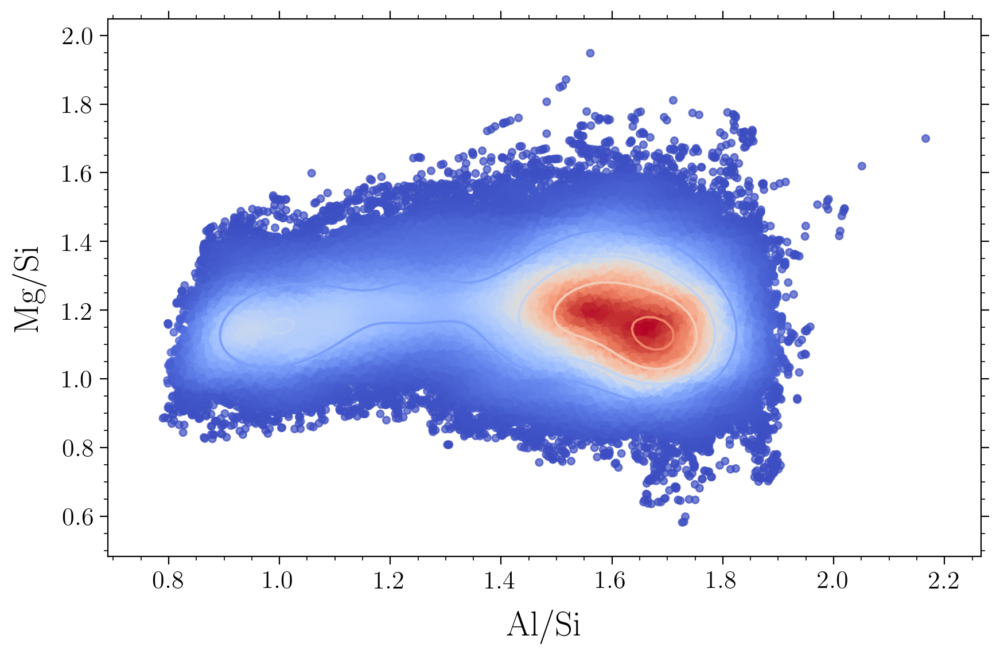

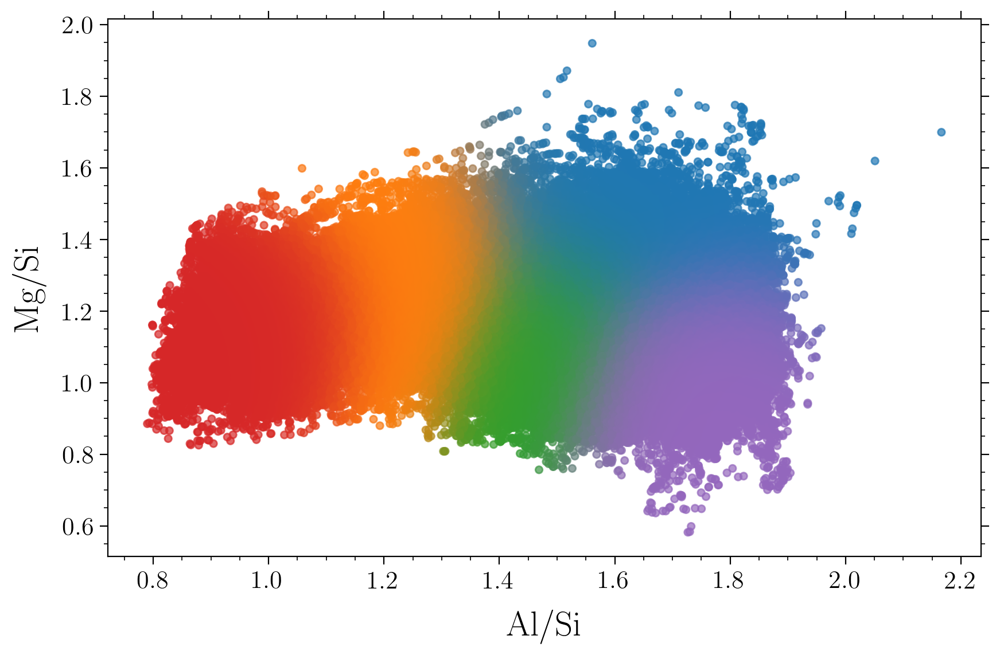

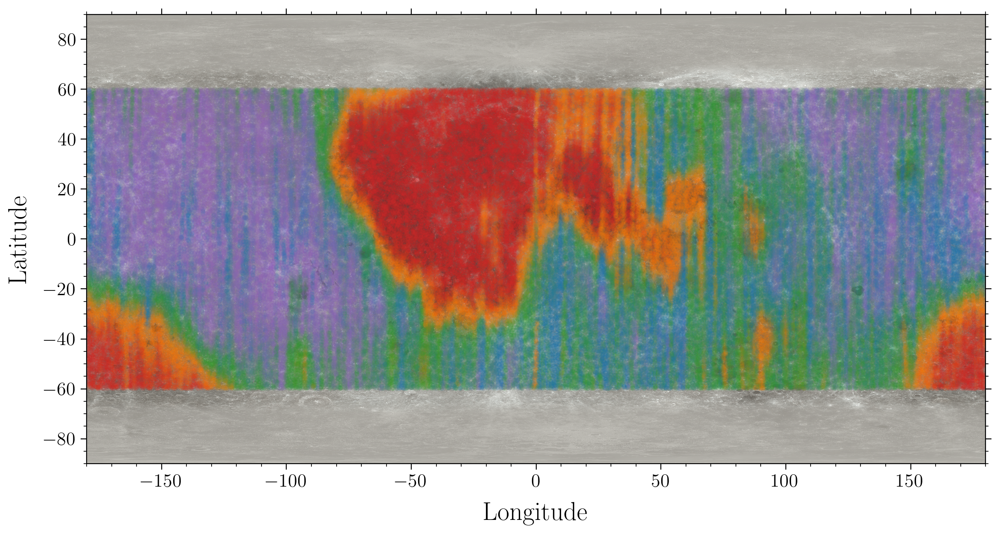

In [15]:
cluster_colors = [f"C{i}" for i in range(5)]
cluster_colors_rgb = np.array([clrs.to_rgb(clr) for clr in cluster_colors])

gmm = gaussian_cluster(sampled_df, 5, cluster_colors_rgb)